# 1. Cel projektu
Proejkt ma na celu stworzenie modelu przybliżającego ocenę wina na podstawie jego cech we wskazanym zbiorze danych

# 2. Dane
Dane dotyczące win pochodzą z https://www.kaggle.com/zynicide/wine-reviews. <br><br>


# 3. Modele



In [20]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
import seaborn as sns
import pickle
from sklearn.neighbors import KNeighborsRegressor
from sklearn.ensemble import ExtraTreesRegressor
from sklearn.tree import DecisionTreeRegressor
from sklearn.metrics import mean_squared_error
from sklearn import metrics
from sklearn.model_selection import train_test_split

# Przygotowanie danych
## Wczytanie surowych danych

In [21]:
wine_dataset_1 = pd.read_json("winemag-data-130k-v2.json")
wine_dataset_2 = pd.read_csv("winemag-data_first150k.csv")
selected_columns =['points','description','price','designation','variety','region_1','region_2','province','country','winery']
set_with_columns_1 = wine_dataset_1[selected_columns]
set_with_columns_2 = wine_dataset_2[selected_columns]

## Połaczenie danych w jeden duży data frame

In [22]:
all_raw_data = set_with_columns_1.append(set_with_columns_2, ignore_index=True)
all_raw_data.head()

,points,description,price,designation,variety,region_1,region_2,province,country,winery
0,87,"Aromas include tropical fruit, broom, brimston...",NaN,Vulkà Bianco,White Blend,Etna,None,Sicily & Sardinia,Italy,Nicosia
1,87,"This is ripe and fruity, a wine that is smooth...",15.0,Avidagos,Portuguese Red,None,None,Douro,Portugal,Quinta dos Avidagos
2,87,"Tart and snappy, the flavors of lime flesh and...",14.0,None,Pinot Gris,Willamette Valley,Willamette Valley,Oregon,US,Rainstorm
3,87,"Pineapple rind, lemon pith and orange blossom ...",13.0,Reserve Late Harvest,Riesling,Lake Michigan Shore,None,Michigan,US,St. Julian
4,87,"Much like the regular bottling from 2012, this...",65.0,Vintner's Reserve Wild Child Block,Pinot Noir,Willamette Valley,Willamette Valley,Oregon,US,Sweet Cheeks


#  Profilowanie dancyh

## Analiza danych numerycznych dla win

In [23]:
profiled_data = all_raw_data.copy()

In [24]:
profiled_data.describe()

,points,price
count,280901.000000,258210.000000
mean,88.146934,34.177162
std,3.151528,38.611708
min,80.000000,4.000000
25%,86.000000,16.000000
50%,88.000000,25.000000
75%,90.000000,40.000000
max,100.000000,3300.000000


## Analiza występowania wartości dla poszczególnych kolumn
### Liczba unikalnych wartości w wybranych kolumnach

In [25]:
#  Wybrane do analizy kolumny
analized_columns = ["designation", "variety", "region_1", "region_2", "province", "country", "winery"]

In [26]:
# Tablica z unikalnymi wartościami dla poszczególnych kolumn
uniques = [profiled_data[x].unique() for x in analized_columns]
# Tablica z ilością tych wartości
uniques_len = [len(x) for x in uniques]

pd.DataFrame(data={"unique_count":uniques_len},index=analized_columns).sort_values(by=["unique_count"], ascending=False)

,unique_count
designation,47241
winery,19186
region_1,1334
variety,757
province,492
country,52
region_2,20


## Analiza z wybraniem 100 najczesciej występujących wartości dla: 
### Variety (pol. szczep)

In [27]:
variety_DF = pd.DataFrame()
variety_DF["count"]  = profiled_data.fillna('no_data').groupby("variety")["variety"].count()
variety_DF = variety_DF.sort_values("count", ascending=False)[:100].reset_index()
variety_DF.head()

,variety,count
0,Pinot Noir,27563
1,Chardonnay,26235
2,Cabernet Sauvignon,22272
3,Red Blend,19008
4,Bordeaux-style Red Blend,14262


### Winery (pol. winnice)

In [28]:
winery_DF = pd.DataFrame()
winery_DF["count"]  = profiled_data.fillna('no_data').groupby("winery")["winery"].count()
winery_DF = winery_DF.sort_values("count", ascending=False)[:100].reset_index()
winery_DF.head()

,winery,count
0,Williams Selyem,585
1,Testarossa,492
2,DFJ Vinhos,473
3,Chateau Ste. Michelle,419
4,Wines & Winemakers,391


### Designation (pol. przeznaczenie)

In [29]:
designation_DF = pd.DataFrame()
designation_DF["count"]  = profiled_data.fillna('no_data').groupby("designation")["designation"].count()
designation_DF = designation_DF.sort_values("count", ascending=False)[:100].reset_index()
designation_DF.head()

,designation,count
0,no_data,83200
1,Reserve,4761
2,Reserva,3069
3,Estate,2893
4,Barrel sample,1701


### Country (pol. kraj)

In [30]:
country_DF = pd.DataFrame()
country_DF["count"]  = profiled_data.fillna('no_data').groupby("country")["country"].count()
country_DF = country_DF.sort_values("count", ascending=False)[:100].reset_index()
country_DF.head()

,country,count
0,US,116901
1,France,43191
2,Italy,43018
3,Spain,14913
4,Portugal,11013


### Province (pol. prowincja,rejon)

In [31]:
province_DF = pd.DataFrame()
province_DF["count"]  = profiled_data.fillna('no_data').groupby("province")["province"].count()
province_DF = province_DF.sort_values("count", ascending=False)[:100].reset_index()
province_DF.head()

,province,count
0,California,80755
1,Washington,18389
2,Tuscany,13178
3,Bordeaux,12052
4,Oregon,9962


### Region 1 i Region 2 

In [32]:
region_1_DF = pd.DataFrame()
region_1_DF["count"]  = profiled_data.fillna('no_data').groupby("region_1")["region_1"].count()
region_1_DF = region_1_DF.sort_values("count", ascending=False)[:100].reset_index()
region_1_DF.head()

,region_1,count
0,no_data,46307
1,Napa Valley,10689
2,Columbia Valley (WA),9099
3,Russian River Valley,6662
4,California,6091


In [33]:
region_2_DF = pd.DataFrame()
region_2_DF["count"]  = profiled_data.fillna('no_data').groupby("region_2")["region_2"].count()
region_2_DF = region_2_DF.sort_values("count", ascending=False)[:100].reset_index()
region_2_DF.head()

,region_2,count
0,no_data,169437
1,Central Coast,24122
2,Sonoma,20286
3,Columbia Valley,17260
4,Napa,15615


## Wizualizacja
### Danych designation, variety, winery

Jak widać na wykresach, kolumna designation jest nieokreśolona dla dużej lości rekodów ilości rekordów. Prawie 1/3 wszystkich danych nie ma wpisu na w tej kolumnie. <br>

Natomiast kolumny variety oraz winery zdają się być bardziej reprezentatywne.

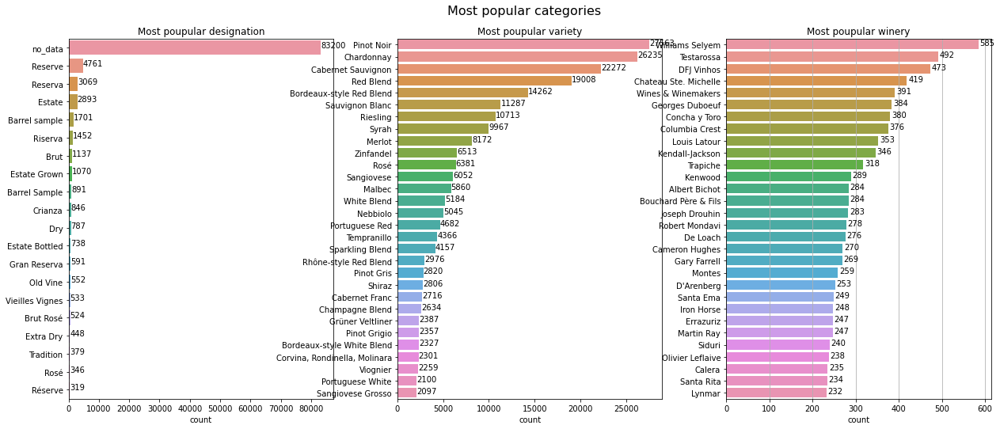

In [34]:
fig, ax = plt.subplots(1,3,figsize=(18,8 ) )
fig.tight_layout(pad=5.0)
plt.grid(True)
fig.suptitle("Most popular categories", fontsize=16)

ax[0].title.set_text('Most poupular designation')
sns.barplot(ax=ax[0], x="count", y="designation", data=designation_DF.head(20))

ax[1].title.set_text('Most poupular variety')
sns.barplot(ax=ax[1], x="count", y="variety", data=variety_DF.head(30))

ax[2].title.set_text('Most poupular winery')
sns.barplot(ax=ax[2], x="count", y="winery", data=winery_DF.head(30))


for a in ax:
    a.set_ylabel('') 
    for p in a.patches:
        height = p.get_height() # height of each horizontal bar is the same
        width = p.get_width() # width (average number of passengers)
        # adding text to each bar
        a.text(x = width+3, # x-coordinate position of data label, padded 3 to right of bar
        y = p.get_y()+(height/3), # # y-coordinate position of data label, padded to be in the middle of the bar
        s = "{:.0f}".format(width), # data label, formatted to ignore decimals
        va = "center") # sets vertical alignment (va) to center


## Wizualizacja danych związanych z lokalizacją
Country, Province, Region 1 i Region 2

<br>
Z Analizy tych danych wynika, że 2/5 wszystkich win w zbniorze pochodzi z USA, a większość z nich z Californii. 
Widać też że kolumny Region 1 i REgion 2 zdają się nie nieść żżadnych istotnych informacji 

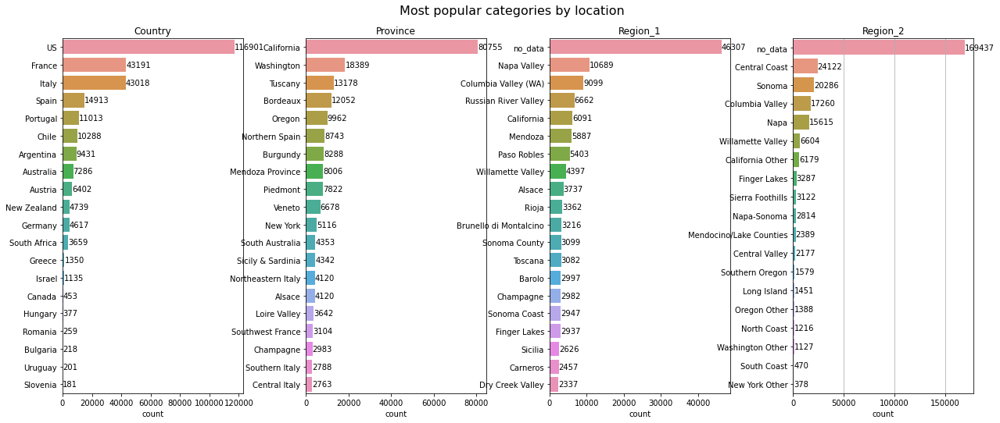

In [35]:
fig, ax = plt.subplots(1,4,figsize=(18,8 ) )
fig.tight_layout(pad=5.0)
plt.grid()

fig.suptitle("Most popular categories by location", fontsize=16)

ax[0].title.set_text('Country')
sns.barplot(ax=ax[0],x="count", y="country", data=country_DF.head(20))

ax[1].title.set_text('Province')
sns.barplot(ax=ax[1],x="count", y="province", data=province_DF.head(20))

ax[2].title.set_text('Region_1')
sns.barplot(ax=ax[2], x="count", y="region_1", data=region_1_DF.head(20))

ax[3].title.set_text('Region_2')
sns.barplot(ax=ax[3], x="count", y="region_2", data=region_2_DF.head(20))


for a in ax:
    a.set_ylabel('') 
    for p in a.patches:
        height = p.get_height() # height of each horizontal bar is the same
        width = p.get_width() # width (average number of passengers)
        # adding text to each bar
        a.text(x = width+3, # x-coordinate position of data label, padded 3 to right of bar
        y = p.get_y()+(height/2), # # y-coordinate position of data label, padded to be in the middle of the bar
        s = "{:.0f}".format(width), # data label, formatted to ignore decimals
        va = "center") # sets vertical alignment (va) to center


# Rozkład ocen
Policznie rozkładu ocen win w zbiorze. 
<br> 
Jak widać na wykresie, dane zdają się mieć rozkład zbilżony do normalnego. Oceny sa z zakresu <80,100> liczb całkowitych

In [39]:
points_DF = profiled_data.copy().drop(["description","price", "designation","variety","region_1","region_2","province","country","winery"], axis=1)
points_DF = points_DF.groupby("points")["points"].count()
points_DF = pd.DataFrame(points_DF.values, index=points_DF.index)
points_DF.reset_index(inplace=True)
points_DF = points_DF.rename(columns = {0:'count'})

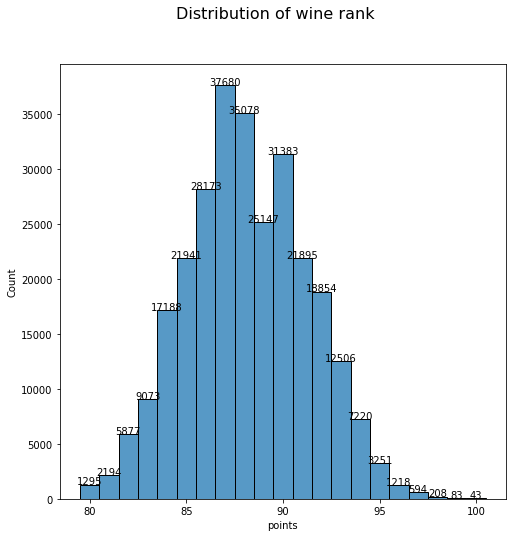

In [40]:
fig, ax = plt.subplots(figsize=(8,8))
sns.histplot(data=profiled_data, x="points",stat="count", discrete=True)
fig.suptitle("Distribution of wine rank", fontsize=16)

for p in ax.patches:
 height = p.get_height() # get the height of each bar
 # adding text to each bar
 ax.text(x = p.get_x()+(p.get_width()/2), # x-coordinate position of data label, padded to be in the middle of the bar
 y = height+0.2, # y-coordinate position of data label, padded 0.2 above bar
 s = "{:.0f}".format(height), # data label, formatted to ignore decimals
 ha = "center") # sets horizontal alignment (ha) to center

# Przygotowanie danych 
Proces przygotowania danych
<ol>
<li>Usunięcie nie uzywanych kolumn</li>
<li>Usunięcie rekordów z wartościami null</li>
<li>Zamiana danych kategorycznych na liczbowe</li>
</ol>

In [41]:
prepared_DF = profiled_data.copy()

## 1. Usunięcie nie-używanych kolumn
Pozostawiamy kolumne decription na razie

In [43]:
prepared_DF = prepared_DF.drop(columns=["region_1", "region_2","designation","description"])
prepared_DF.head()

,points,price,variety,province,country,winery
0,87,NaN,White Blend,Sicily & Sardinia,Italy,Nicosia
1,87,15.0,Portuguese Red,Douro,Portugal,Quinta dos Avidagos
2,87,14.0,Pinot Gris,Oregon,US,Rainstorm
3,87,13.0,Riesling,Michigan,US,St. Julian
4,87,65.0,Pinot Noir,Oregon,US,Sweet Cheeks


## 2. Usunięcie rekordów z wartościami null

In [44]:
prepared_DF = prepared_DF.dropna()

In [45]:
prepared_DF

,points,price,variety,province,country,winery
1,87,15.0,Portuguese Red,Douro,Portugal,Quinta dos Avidagos
2,87,14.0,Pinot Gris,Oregon,US,Rainstorm
3,87,13.0,Riesling,Michigan,US,St. Julian
4,87,65.0,Pinot Noir,Oregon,US,Sweet Cheeks
5,87,15.0,Tempranillo-Merlot,Northern Spain,Spain,Tandem
...,...,...,...,...,...,...
280896,91,20.0,White Blend,Southern Italy,Italy,Feudi di San Gregorio
280897,91,27.0,Champagne Blend,Champagne,France,H.Germain
280898,91,20.0,White Blend,Southern Italy,Italy,Terredora
280899,90,52.0,Champagne Blend,Champagne,France,Gosset


## 3. Zamiana danych kategorycznych na liczbowe

In [46]:
prepared_DF_t = prepared_DF.copy()

In [47]:
prepared_DF_t["variety"] = prepared_DF_t.variety.astype('category')
prepared_DF_t["province"]= prepared_DF_t.province.astype('category')
prepared_DF_t["country"]= prepared_DF_t.country.astype('category')
prepared_DF_t.head(100)

,points,price,variety,province,country,winery
1,87,15.0,Portuguese Red,Douro,Portugal,Quinta dos Avidagos
2,87,14.0,Pinot Gris,Oregon,US,Rainstorm
3,87,13.0,Riesling,Michigan,US,St. Julian
4,87,65.0,Pinot Noir,Oregon,US,Sweet Cheeks
5,87,15.0,Tempranillo-Merlot,Northern Spain,Spain,Tandem
...,...,...,...,...,...,...
103,87,18.0,Chardonnay,Leyda Valley,Chile,Leyda
104,87,16.0,Red Blend,Tuscany,Italy,Madonna Alta
105,87,14.0,White Blend,Tuscany,Italy,Marchesi Antinori
106,87,30.0,Red Blend,Tuscany,Italy,Marchesi de' Frescobaldi


In [48]:
cat_codes = prepared_DF_t.copy()
# cat_codes.drop(["points","price","descritpion_score_norm"],axis='columns', inplace=True)
prepared_DF_t["variety"] = prepared_DF_t["variety"].astype('category', copy=True).cat.codes
prepared_DF_t["province"] = prepared_DF_t["province"].astype('category', copy=True).cat.codes
prepared_DF_t["country"] = prepared_DF_t["country"].astype('category', copy=True).cat.codes
prepared_DF_t["winery"] = prepared_DF_t["winery"].astype('category', copy=True).cat.codes

In [49]:
prepared_DF_t.head()

,points,price,variety,province,country,winery
1,87,15.0,476,115,34,13900
2,87,14.0,462,303,44,13971
3,87,13.0,506,243,44,15485
4,87,65.0,466,303,44,15738
5,87,15.0,624,294,41,15825


# Przygotowanie modelu
## Podzielenie danych na testowy i uczący

In [50]:
y = prepared_DF_t["points"]
x = prepared_DF_t.drop(columns=['points'])

In [51]:
x_train, x_test, y_train, y_test = train_test_split(x,y,test_size=0.3,random_state=9)

## Trening modeli
### ExtraTree regresor

In [53]:
model_tree = ExtraTreesRegressor(n_jobs = 7)

In [54]:
model_tree.fit(x_train,y_train)

ExtraTreesRegressor(n_jobs=7)

### KNN regressor

In [55]:
model_KNN = KNeighborsRegressor(n_neighbors=3, n_jobs = 7)

In [56]:
model_KNN.fit(x_train,y_train)

KNeighborsRegressor(n_jobs=7, n_neighbors=3)

### Sieć neuronowa

In [57]:
from keras.models import Sequential
from keras.layers import Dense
import tensorflow as tf
from tensorflow import keras
from sklearn.preprocessing import StandardScaler
from keras.layers import Dropout
from sklearn.preprocessing import MinMaxScaler

In [72]:

X_train,X_test,Y_train,Y_test = x_train, x_test,y_train, y_test
sc = MinMaxScaler()

X_train = X_train.to_numpy()
Y_train = Y_train.to_numpy()
X_test = X_test.to_numpy()
Y_test = Y_test.to_numpy()

model_NN = Sequential()
model_NN.add(Dense(50, input_dim=5, activation='softplus'))
model_NN.add(Dense(200, activation='softplus'))
model_NN.add(Dropout(0.2))
model_NN.add(Dense(50, activation='softplus'))
model_NN.add(Dense(1, activation=lambda x: tf.clip_by_value(x, 80, 100)))
model_NN.compile(loss='mean_absolute_error', metrics=['mean_absolute_error','mean_squared_error'], optimizer='Adamax')


In [73]:
history =  model_NN.fit(X_train, Y_train, epochs=10, batch_size=32)

Epoch 1/10
5647/5647 [==============================] - 10s 2ms/step - loss: 8.0831 - mean_absolute_error: 8.0831 - mean_squared_error: 75.3180
Epoch 2/10
5647/5647 [==============================] - 8s 1ms/step - loss: 8.0806 - mean_absolute_error: 8.0806 - mean_squared_error: 75.2470
Epoch 3/10
5647/5647 [==============================] - 9s 2ms/step - loss: 8.0952 - mean_absolute_error: 8.0952 - mean_squared_error: 75.5472
Epoch 4/10
5647/5647 [==============================] - 8s 1ms/step - loss: 8.0957 - mean_absolute_error: 8.0957 - mean_squared_error: 75.4769
Epoch 5/10
5647/5647 [==============================] - 9s 2ms/step - loss: 8.0845 - mean_absolute_error: 8.0845 - mean_squared_error: 75.2866
Epoch 6/10
5647/5647 [==============================] - 9s 2ms/step - loss: 8.0946 - mean_absolute_error: 8.0946 - mean_squared_error: 75.4455
Epoch 7/10
5647/5647 [==============================] - 8s 1ms/step - loss: 8.0830 - mean_absolute_error: 8.0830 - mean_squared_error: 75.279

# Ewaluacja

In [74]:
def test_model(x_test,y_test,model):
    y_pred = model.predict(x_test)
    # policzenie metryk
    mae = round(metrics.mean_absolute_error(y_test, y_pred),3)
    mse = round(metrics.mean_squared_error(y_test, y_pred, squared=False),3)
    r2 = round(metrics.r2_score(y_test, y_pred),3)
    return mae,mse,r2,y_pred


In [75]:
class ModelPredData:
    name = ''
    prediction = []
    def __init__(self, name='', prediction=[]):
            self.name = name
            self.prediction = prediction

In [76]:
def make_preditions(models, names, x_test, y_test):
    MSE_tab = []
    MAE_tab = []
    R2_tab = []
    models_data = []

    for i,_model in enumerate(models):
        mae,mse,r2,y_pred_tmp = test_model(x_test,y_test,_model)
        MSE_tab.append(mse)
        MAE_tab.append(mae)
        R2_tab.append(r2)
        models_data.append( ModelPredData(names[i], y_pred_tmp))

    results_metrics_DF = pd.DataFrame({"MAE":MAE_tab,"MSE":MSE_tab, "R2":R2_tab, "Model":names } )

    return results_metrics_DF, models_data 

In [77]:
def create_plot(data_tab, results_metrics, y_test : []):
    y_min, y_max = y_test.min(), y_test.max()
    
    fig, ax = plt.subplots(1, 3 ,figsize=(30,8))

    x = 0
    y = 0
    for idx, model_info in enumerate(data_tab):
       
        result_DF = pd.DataFrame({"Actual":y_test, "Predicted":model_info.prediction})
        sns.scatterplot(ax=ax[y],data=result_DF, x="Actual", y="Predicted")
        ax[y].plot([y_min, y_max], [ y_min, y_max], 'r--', lw=3)
        ax[y].grid(True)
        ax[y].set_title(model_info.name)
        print(model_info.name, " - Plotted")
        y+=1
       

    plt.show()

### Zbieranie danych dla modeli ExtraTree oraz KNN

In [78]:
results_metrics_DF, models_data = make_preditions([model_tree, model_KNN], ["model_tree", "model_KNN"], x_test, y_test)

In [79]:
results_metrics_DF

,MAE,MSE,R2,Model
0,1.210,1.941,0.622,model_tree
1,1.628,2.206,0.511,model_KNN


### Zbieranie danych dla NN

In [80]:
Y_pred = model_NN.predict(X_test)

In [81]:
mae = round(metrics.mean_absolute_error(Y_test, Y_pred),3)
mse = round(metrics.mean_squared_error(Y_test, Y_pred, squared=False),3)
r2 = round(metrics.r2_score(Y_test,Y_pred),3)


In [82]:
# Dodanie wyników NN
models_data.append(ModelPredData("model_NN", Y_pred.flatten()))


In [83]:
results_metrics_DF.append({"MAE":mae,"MSE":mse, "R2":r2, "Model":"model_NN"}, ignore_index=True)

,MAE,MSE,R2,Model
0,1.210,1.941,0.622,model_tree
1,1.628,2.206,0.511,model_KNN
2,8.082,8.676,-6.563,model_NN


## Wyniki - czerwona linia oznacza idealne dopasowanie

model_tree  - Plotted
model_KNN  - Plotted
model_NN  - Plotted


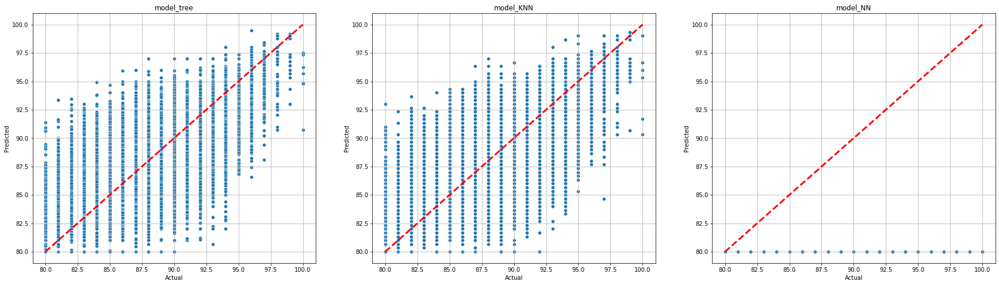

In [84]:
create_plot(models_data, results_metrics_DF, y_test, )

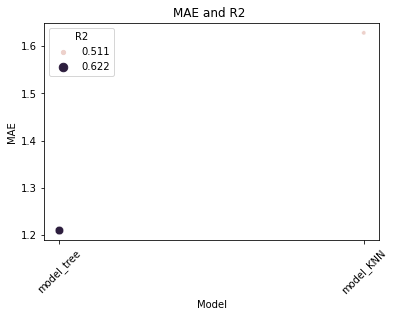

In [85]:
sns.scatterplot(
    data=results_metrics_DF, x="Model", y="MAE", size="R2", hue="R2")

plt.title("MAE and R2 ")
plt.xticks(rotation=45)
plt.show()